<a href="https://colab.research.google.com/github/ADARSHBNM/assignment_files/blob/main/Electric_motor_temperature.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

**BUSSINESS PROBLEM**

**Our goal is to Predict Motor Speed**

so basically our project is Electric Motor Tempreature, in which Our main goal is to Predict Motor Speed based on the attributes available

Working of Electric motor

Electric Motor : An electric motor (dc motor) works on the principle that when an electric current is passed through a conductor placed normally in a magnetic field, a force acts on the conductor as a result of which the conductor begins to move and mechanical energy is obtained.

Why is an electric motor get hot?

When a motor doesn't have the right voltage support it needs to work harder to perform, which comes parts over heat.

How does temperature effects electric motor?  

As the motor temperature increases the resistance will increase and the torque constant and voltage constant will decrease this affects the motor performance.


 so ,now lets talk about the attributes  available and the first one is

Ambient : The Ambient temperature is the air temperature and it is measured by a thermal sensor located closely to the stator.

coolant :A coolant is a substance, typically liquid, that is used to reduce the temperature of motor. The motor is water cooled and the Measurement is taken at the outflow.


u_d : voltage at d component .

u_q : voltage at q component .

motor_speed : It is just the speed of the motor measured in (rpm).

torque : The torque of motor is the amount of rotational force that the motor develops.Torque induced by current.

i_d: current at d component .

i_q: current at q component .

pm: Permanent Magnet surface temperature representing the rotor temperature. This was measured with an infrared thermography unit.

stator_yoke: it is temperatue at stator yoke measures with thermal sensor.

stator_tooth: it is temperatue at stator tooth measures with thermal sensor.

stator_winding: it is temperatue at stator winding measures with thermal sensor.

profile_id: It is Measurement session id. Each distinct measurement session can be identified through this integer id.

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import warnings
warnings.filterwarnings('ignore')



## Importing Datasets

In [ ]:
motor = pd.read_csv('/content/temperature_data.csv',error_bad_lines=False)

In [ ]:
motor.head()

,ambient,coolant,u_d,u_q,motor_speed,torque,i_d,i_q,pm,stator_yoke,stator_tooth,stator_winding,profile_id
0,-0.752143,-1.118446,0.327935,-1.297858,-1.222428,-0.250182,1.029572,-0.245860,-2.522071,-1.831422,-2.066143,-2.018033,4
1,-0.771263,-1.117021,0.329665,-1.297686,-1.222429,-0.249133,1.029509,-0.245832,-2.522418,-1.830969,-2.064859,-2.017631,4
2,-0.782892,-1.116681,0.332771,-1.301822,-1.222428,-0.249431,1.029448,-0.245818,-2.522673,-1.830400,-2.064073,-2.017343,4
3,-0.780935,-1.116764,0.333700,-1.301852,-1.222430,-0.248636,1.032845,-0.246955,-2.521639,-1.830333,-2.063137,-2.017632,4
4,-0.774043,-1.116775,0.335206,-1.303118,-1.222429,-0.248701,1.031807,-0.246610,-2.521900,-1.830498,-2.062795,-2.018145,4


In [ ]:
motor.shape

(998070, 13)

In [ ]:
motor.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 998070 entries, 0 to 998069
Data columns (total 13 columns):
 #   Column          Non-Null Count   Dtype  
---  ------          --------------   -----  
 0   ambient         998070 non-null  float64
 1   coolant         998070 non-null  float64
 2   u_d             998070 non-null  float64
 3   u_q             998070 non-null  float64
 4   motor_speed     998070 non-null  float64
 5   torque          998070 non-null  float64
 6   i_d             998070 non-null  float64
 7   i_q             998070 non-null  float64
 8   pm              998070 non-null  float64
 9   stator_yoke     998070 non-null  float64
 10  stator_tooth    998070 non-null  float64
 11  stator_winding  998070 non-null  float64
 12  profile_id      998070 non-null  int64  
dtypes: float64(12), int64(1)
memory usage: 99.0 MB


In [ ]:
motor.describe().T

,count,mean,std,min,25%,50%,75%,max
ambient,998070.0,-0.003905,0.993127,-8.573954,-0.599385,0.266157,0.686675,2.967117
coolant,998070.0,0.004723,1.002423,-1.429349,-1.037925,-0.177187,0.650709,2.649032
u_d,998070.0,0.004780,0.997878,-1.655373,-0.826359,0.267542,0.358491,2.274734
u_q,998070.0,-0.005690,1.002330,-1.861463,-0.927390,-0.099818,0.852625,1.793498
motor_speed,998070.0,-0.006336,1.001229,-1.371529,-0.951892,-0.140246,0.853584,2.024164
torque,998070.0,-0.003333,0.997907,-3.345953,-0.266917,-0.187246,0.547171,3.016971
i_d,998070.0,0.006043,0.998994,-3.245874,-0.756296,0.213935,1.013975,1.060937
i_q,998070.0,-0.003194,0.997912,-3.341639,-0.257269,-0.190076,0.499260,2.914185
pm,998070.0,-0.004396,0.995686,-2.631991,-0.672308,0.094367,0.680691,2.917456
stator_yoke,998070.0,0.000609,1.001049,-1.834688,-0.747265,-0.057226,0.697344,2.449158


In [ ]:
motor.corr()['ambient']


ambient           1.000000
coolant           0.434435
u_d               0.194754
u_q               0.087430
motor_speed       0.078283
torque           -0.262264
i_d               0.005605
i_q              -0.260562
pm                0.501496
stator_yoke       0.451616
stator_tooth      0.396742
stator_winding    0.301883
profile_id        0.384565
Name: ambient, dtype: float64

In [ ]:
motor.corr()['coolant']

ambient           0.434435
coolant           1.000000
u_d               0.178708
u_q               0.027851
motor_speed      -0.033332
torque           -0.189617
i_d               0.108489
i_q              -0.186060
pm                0.430548
stator_yoke       0.874037
stator_tooth      0.689003
stator_winding    0.509298
profile_id        0.499669
Name: coolant, dtype: float64

In [ ]:
motor.corr()['u_q']

ambient           0.087430
coolant           0.027851
u_d              -0.027472
u_q               1.000000
motor_speed       0.716897
torque           -0.037262
i_d              -0.181855
i_q              -0.026348
pm                0.101236
stator_yoke       0.106186
stator_tooth      0.149017
stator_winding    0.125445
profile_id       -0.122260
Name: u_q, dtype: float64

In [ ]:
motor.corr()['u_d']

ambient           0.194754
coolant           0.178708
u_d               1.000000
u_q              -0.027472
motor_speed      -0.233828
torque           -0.821325
i_d               0.358517
i_q              -0.796586
pm               -0.082564
stator_yoke       0.041428
stator_tooth     -0.066256
stator_winding   -0.150714
profile_id        0.300771
Name: u_d, dtype: float64

In [ ]:
motor.corr()['i_d']

ambient           0.005605
coolant           0.108489
u_d               0.358517
u_q              -0.181855
motor_speed      -0.722914
torque           -0.239059
i_d               1.000000
i_q              -0.204230
pm               -0.299227
stator_yoke      -0.179903
stator_tooth     -0.387712
stator_winding   -0.539924
profile_id        0.142368
Name: i_d, dtype: float64

In [ ]:
motor.corr()['i_q']

ambient          -0.260562
coolant          -0.186060
u_d              -0.796586
u_q              -0.026348
motor_speed       0.006323
torque            0.996560
i_d              -0.204230
i_q               1.000000
pm               -0.086486
stator_yoke      -0.098753
stator_tooth     -0.025191
stator_winding    0.060949
profile_id       -0.256127
Name: i_q, dtype: float64

In [ ]:
motor.corr()['pm']

ambient           0.501496
coolant           0.430548
u_d              -0.082564
u_q               0.101236
motor_speed       0.332419
torque           -0.072905
i_d              -0.299227
i_q              -0.086486
pm                1.000000
stator_yoke       0.695014
stator_tooth      0.768352
stator_winding    0.729561
profile_id        0.156735
Name: pm, dtype: float64

In [ ]:

motor.corr()['stator_yoke']

ambient           0.451616
coolant           0.874037
u_d               0.041428
u_q               0.106186
motor_speed       0.182564
torque           -0.092207
i_d              -0.179903
i_q              -0.098753
pm                0.695014
stator_yoke       1.000000
stator_tooth      0.949898
stator_winding    0.845144
profile_id        0.398021
Name: stator_yoke, dtype: float64

In [ ]:
motor.corr()['stator_tooth']

ambient           0.396742
coolant           0.689003
u_d              -0.066256
u_q               0.149017
motor_speed       0.333909
torque           -0.011055
i_d              -0.387712
i_q              -0.025191
pm                0.768352
stator_yoke       0.949898
stator_tooth      1.000000
stator_winding    0.965633
profile_id        0.280994
Name: stator_tooth, dtype: float64

In [ ]:
motor.corr()['stator_winding']

ambient           0.301883
coolant           0.509298
u_d              -0.150714
u_q               0.125445
motor_speed       0.393154
torque            0.080981
i_d              -0.539924
i_q               0.060949
pm                0.729561
stator_yoke       0.845144
stator_tooth      0.965633
stator_winding    1.000000
profile_id        0.181908
Name: stator_winding, dtype: float64

In [ ]:
#checking correlation with respect to torque
motor.corr()['torque']


ambient          -0.262264
coolant          -0.189617
u_d              -0.821325
u_q              -0.037262
motor_speed       0.024517
torque            1.000000
i_d              -0.239059
i_q               0.996560
pm               -0.072905
stator_yoke      -0.092207
stator_tooth     -0.011055
stator_winding    0.080981
profile_id       -0.257446
Name: torque, dtype: float64

In [ ]:
#checking correlation with respect to motor_speed
motor.corr()['motor_speed']

ambient           0.078283
coolant          -0.033332
u_d              -0.233828
u_q               0.716897
motor_speed       1.000000
torque            0.024517
i_d              -0.722914
i_q               0.006323
pm                0.332419
stator_yoke       0.182564
stator_tooth      0.333909
stator_winding    0.393154
profile_id       -0.166225
Name: motor_speed, dtype: float64

In [ ]:
corr_motor_speed=motor.corr()['motor_speed']


In [ ]:
y=corr_motor_speed.to_list()
x=motor.columns


([<matplotlib.axis.XTick at 0x7810e018a440>,
 [Text(0.0, 0, 'ambient'),
  Text(1.0, 0, 'coolant'),
  Text(2.0, 0, 'u_d'),
  Text(3.0, 0, 'u_q'),
  Text(4.0, 0, 'motor_speed'),
  Text(5.0, 0, 'torque'),
  Text(6.0, 0, 'i_d'),
  Text(7.0, 0, 'i_q'),
  Text(8.0, 0, 'pm'),
  Text(9.0, 0, 'stator_yoke'),
  Text(10.0, 0, 'stator_tooth'),
  Text(11.0, 0, 'stator_winding'),
  Text(12.0, 0, 'profile_id')])

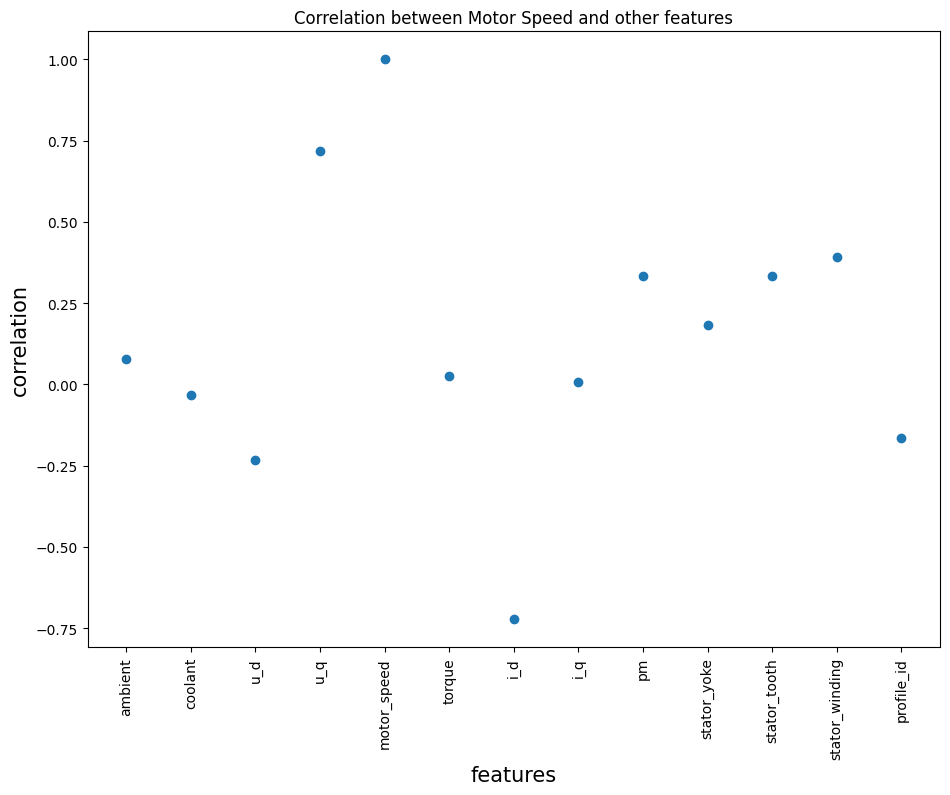

In [ ]:
plt.figure(figsize=[11,8])
plt.scatter(x,y,)
plt.title("Correlation between Motor Speed and other features")
plt.xlabel("features", size=15)
plt.ylabel("correlation", size=15)
plt.xticks(x, [str(i) for i in x], rotation=90)

Formula for motor temperature rise:    
Temperature =hot temperature - ambient temperature


Factors affecting motor performance         
*voltage of power supply        
*winding specifications      
*Environmental temperature       
*Type of magnet       
  




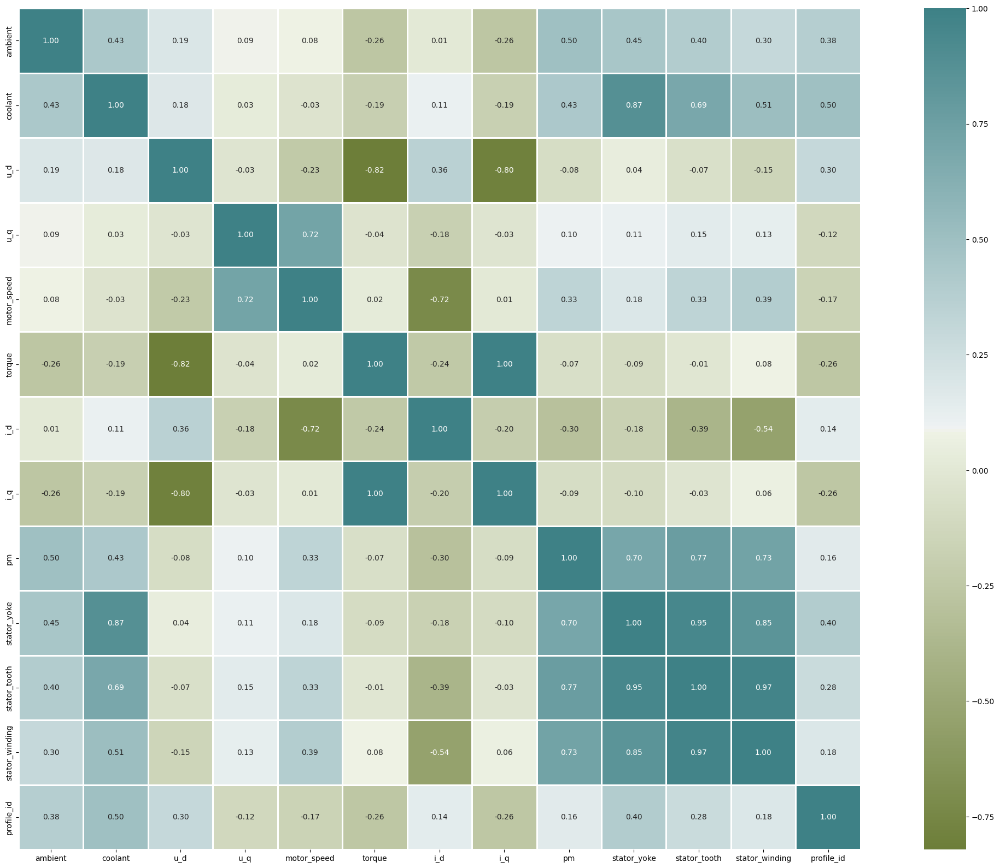

In [ ]:
#correlation map
cax=plt.subplots(figsize=(30,20))
corr=motor.corr()
sns.heatmap(corr, annot=True , linewidths=1, fmt='.2f',
            mask= np.zeros_like(corr,dtype=np.bool),
            cmap=sns.diverging_palette(100,200,as_cmap=True),
            square=True)

plt.show()

<Axes: >

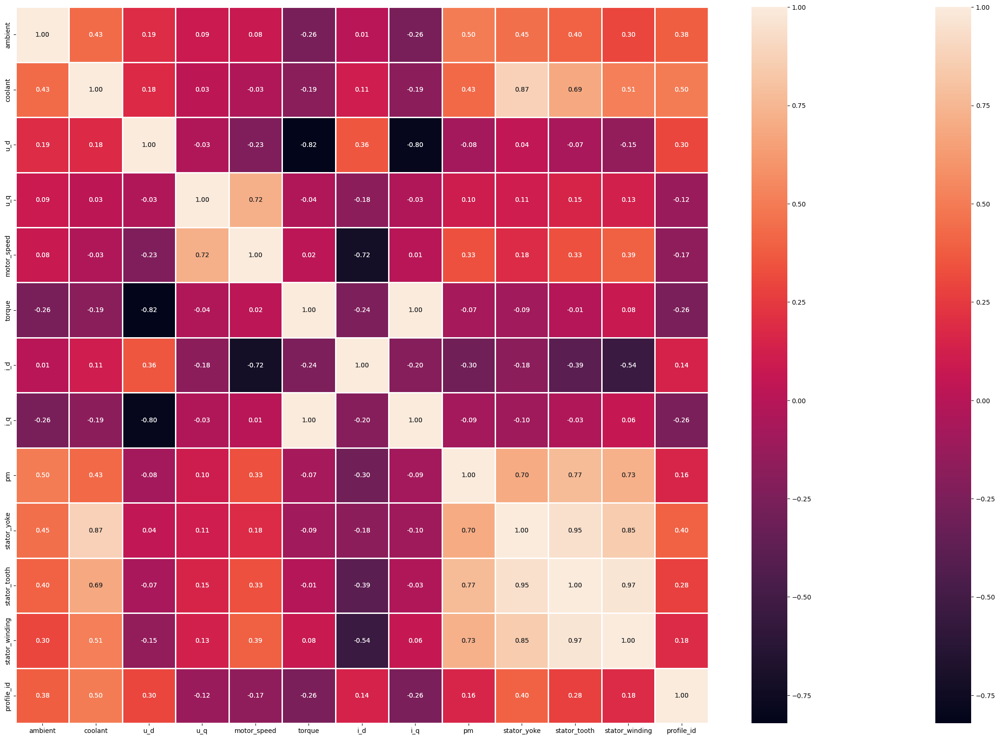

In [ ]:
ax=plt.subplots(figsize=(30,20))
#sns.heatmap(motor.corr())
sns.heatmap(motor.corr(), annot=True, linewidths=1, fmt='.2f', mask= np.zeros_like(motor.corr(),dtype=np.bool))
sns.heatmap(motor.corr(), annot=True, linewidths=1, fmt='.2f', mask= np.zeros_like(motor.corr(),dtype=np.bool))



In [ ]:
#checking for missing data
motor.isnull().sum()

ambient           0
coolant           0
u_d               0
u_q               0
motor_speed       0
torque            0
i_d               0
i_q               0
pm                0
stator_yoke       0
stator_tooth      0
stator_winding    0
profile_id        0
dtype: int64

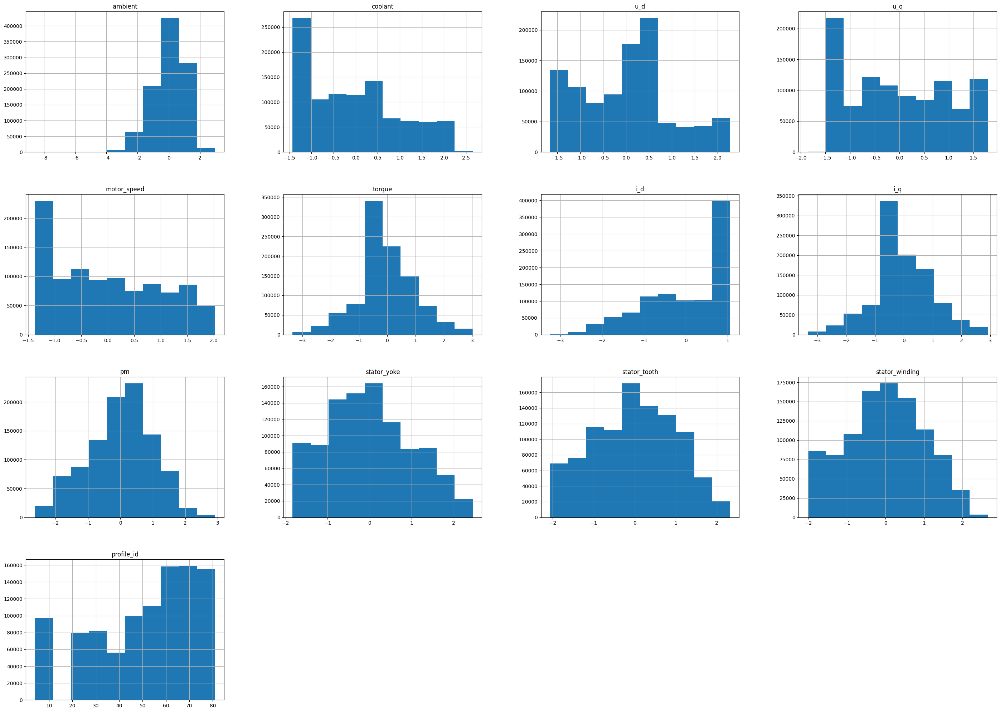

In [ ]:
motor.hist(figsize = (35,25))
plt.show()

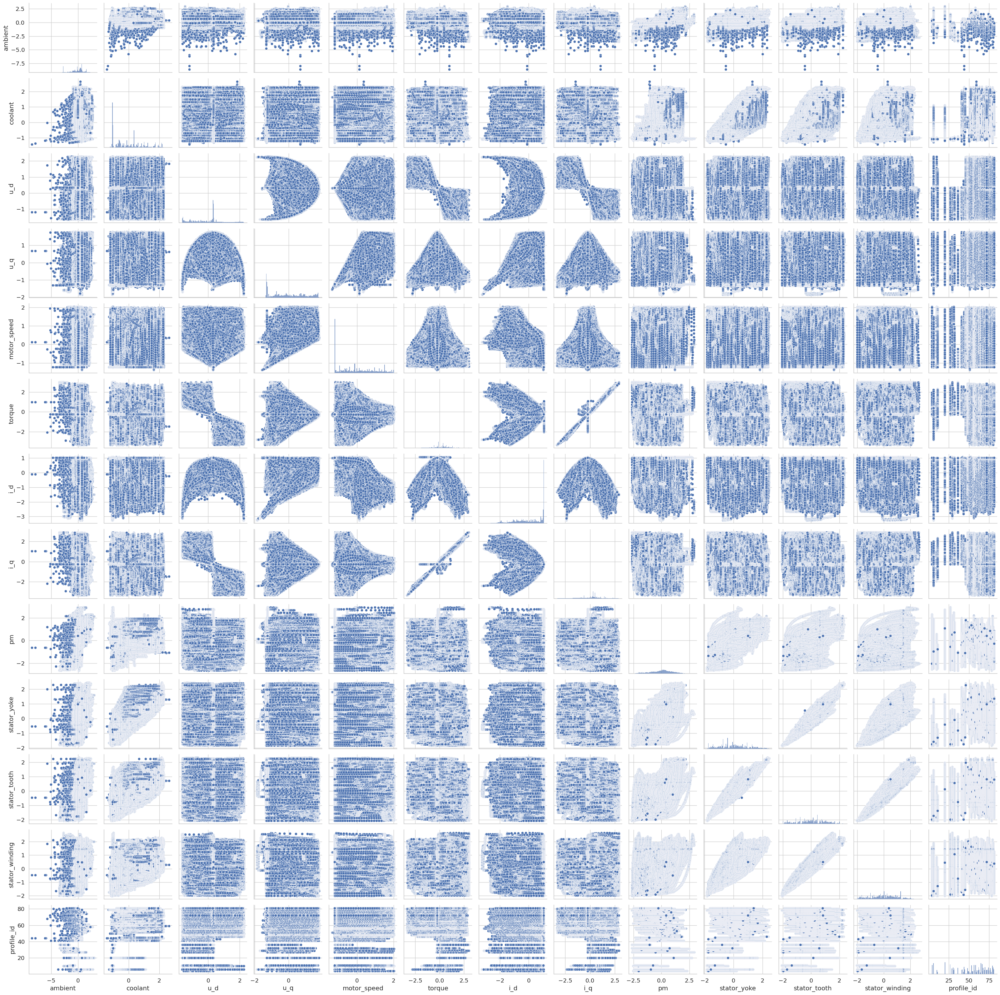

In [ ]:
sns.pairplot(motor)

In [ ]:
#checking for duplicates in the dataset
motor1=motor.drop_duplicates(keep='first')


In [ ]:
motor1.shape

(998070, 13)

In [ ]:
# There is no duplicate values present in the dataset


Text(0.5, 1.0, 'Count of profile_id')

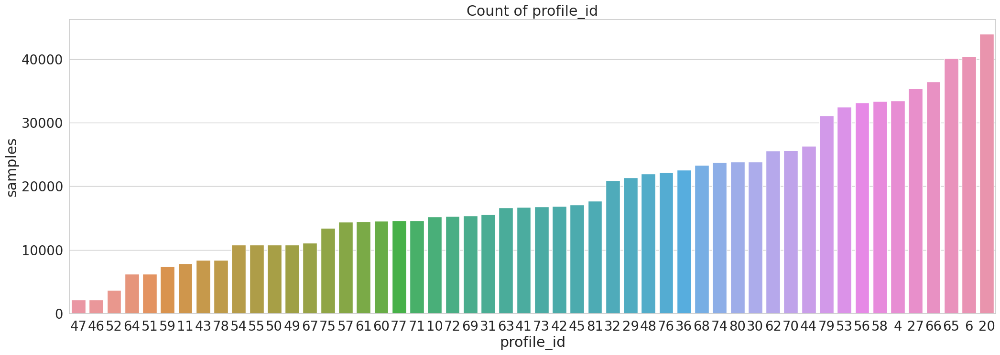

In [ ]:
#barplot for profile_id
sns.set(style="whitegrid", font_scale=1.8)
plt.subplots(figsize = (25,8))
grpd = motor.groupby(['profile_id'])
_df = grpd.size().sort_values().rename('samples').reset_index()
ordered_ids = _df.profile_id.values.tolist()
sns.barplot(y='samples', x='profile_id', data=_df, order=ordered_ids).set_title('Count of profile_id')


<Axes: xlabel='profile_id', ylabel='motor_speed'>

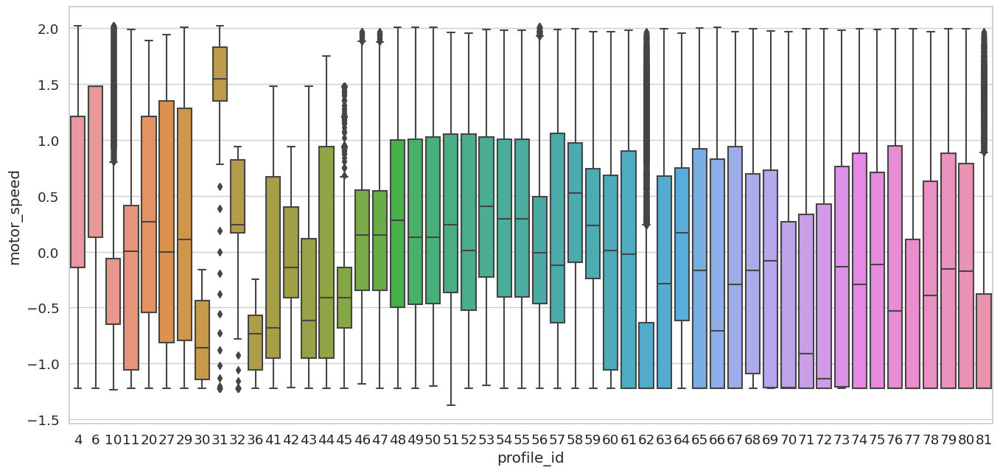

In [ ]:
sns.set(style="whitegrid", font_scale=1.2)
plt.subplots(figsize = (55,25))
plt.subplot(3,3,1)
sns.boxplot(x='profile_id', y='motor_speed', data=motor)


In [ ]:
get_ipython().system('pip install sweetviz')
get_ipython().system('pip install pandas_profiling')
#pip install markupsafe
import sweetviz as sv
sweet_report = sv.analyze(motor)
sweet_report.show_html('temperature_data.html')


     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 15.1/15.1 MB 22.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 324.4/324.4 kB 4.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 353.0/353.0 kB 7.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 102.7/102.7 kB 8.3 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 679.5/679.5 kB 9.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 296.5/296.5 kB 9.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 455.4/455.4 kB 10.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.7/4.7 MB 19.1 MB/s eta 0:00:00
  Created wheel for htmlmin: filename=htmlmin-0.1.12-py3-none-any.whl size=27081 sha256=550639541c990e018e331f94395cb7b938f531ca7f115e9443680f91b17dedc4
  Stored in directory: /root/.cache/pip/wheels/dd/91/29/a79cecb328d01739e64017b6fb9a1ab9d8cb1853098ec5966d
Successfully built htmlmin
  Attempting uninstall: wo

                                             |          | [  0%]   00:00 -> (? left)

Report temperature_data.html was generated! NOTEBOOK/COLAB USERS: the web browser MAY not pop up, regardless, the report IS saved in your notebook/colab files.


In [ ]:
import numpy as np
np.seterr(all='warn')
A = np.array([10])
a=A[-1]
a**a
import pandas_profiling as pp
EDA_report= pp.ProfileReport(motor)
EDA_report.to_file(output_file='report.html')
EDA_report

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

In [ ]:
from statsmodels.graphics.regressionplots import influence_plot
import statsmodels.formula.api as smf

In [ ]:
model=smf.ols('motor_speed~ambient+coolant+u_d+u_q+torque+i_q+i_d+pm+stator_yoke+stator_tooth+stator_winding',data=motor).fit()


In [ ]:
model.rsquared

0.9280781257588528

In [ ]:
#with out feature reduction we have got 92 percent acurracy which is really good.

In [ ]:
model.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:            motor_speed   R-squared:                       0.928
Model:                            OLS   Adj. R-squared:                  0.928
Method:                 Least Squares   F-statistic:                 1.171e+06
Date:                Tue, 25 Jul 2023   Prob (F-statistic):               0.00
Time:                        15:51:39   Log-Likelihood:            -1.0388e+05
No. Observations:              998070   AIC:                         2.078e+05
Df Residuals:                  998058   BIC:                         2.079e+05
Df Model:                          11                                         
Covariance Type:            nonrobust                                         
==================================================================================
                     coef    std err          t      P>|t|      [0.025      0.975]
----------------------------------------------------------------------------------
Intercept          0.0006      0.000      2.399      0.016       0.000       0.001
ambient           -0.0504      0.000   -147.501      0.000      -0.051      -0.050
coolant            0.4102      0.002    244.356      0.000       0.407       0.413
u_d               -0.1661      0.001   -285.502      0.000      -0.167      -0.165
u_q                0.5395      0.000   1646.147      0.000       0.539       0.540
torque            -0.3442      0.004    -79.190      0.000      -0.353      -0.336
i_q                0.1381      0.004     33.779      0.000       0.130       0.146
i_d               -0.6577      0.000  -1417.144      0.000      -0.659      -0.657
pm                 0.1063      0.001    191.352      0.000       0.105       0.107
stator_yoke       -1.6290      0.005   -315.783      0.000      -1.639      -1.619
stator_tooth       2.3192      0.007    340.321      0.000       2.306       2.333
stator_winding    -1.1684      0.003   -346.265      0.000      -1.175      -1.162
==============================================================================
Omnibus:                    53747.933   Durbin-Watson:                   0.003
Prob(Omnibus):                  0.000   Jarque-Bera (JB):           205507.215
Skew:                          -0.118   Prob(JB):                         0.00
Kurtosis:                       5.210   Cond. No.                         69.2
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

In [ ]:
#building the model by excluding on of the feature which are dependent to each other
model2=smf.ols('motor_speed~u_q+i_d+stator_winding+pm+stator_tooth+torque',data=motor).fit()

In [ ]:
model2.rsquared

0.9071505339762779

In [ ]:
motor_cpy=motor.copy()

In [ ]:
motor_cpy['u_q_sqrd']=motor_cpy['u_q']**2
motor_cpy['i_d_sqrd']=motor_cpy['i_q']**2
motor_cpy['stator_tooth_sqrd']=motor_cpy['stator_tooth']**2
motor_cpy['stator_winding_sqrd']=motor_cpy['stator_winding']**2


In [ ]:
motor_cpy.head()
motor_cpy=motor_cpy.drop(['stator_tooth_sqrd','stator_winding_sqrd'],axis=1)


In [ ]:
model3=smf.ols('motor_speed~ambient+coolant+u_d+u_q+torque+i_q+i_d+pm+stator_yoke+stator_tooth+stator_winding+u_q_sqrd+i_d_sqrd',data=motor_cpy).fit()


In [ ]:
model3.rsquared

0.972634265034531

In [ ]:
model3.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:            motor_speed   R-squared:                       0.973
Model:                            OLS   Adj. R-squared:                  0.973
Method:                 Least Squares   F-statistic:                 2.729e+06
Date:                Tue, 25 Jul 2023   Prob (F-statistic):               0.00
Time:                        15:52:57   Log-Likelihood:             3.7833e+05
No. Observations:              998070   AIC:                        -7.566e+05
Df Residuals:                  998056   BIC:                        -7.565e+05
Df Model:                          13                                         
Covariance Type:            nonrobust                                         
==================================================================================
                     coef    std err          t      P>|t|      [0.025      0.975]
----------------------------------------------------------------------------------
Intercept          0.1799      0.000    528.095      0.000       0.179       0.181
ambient           -0.0176      0.000    -82.705      0.000      -0.018      -0.017
coolant            0.2160      0.001    206.347      0.000       0.214       0.218
u_d               -0.0563      0.000   -151.285      0.000      -0.057      -0.056
u_q                0.5191      0.000   2468.124      0.000       0.519       0.519
torque            -0.5399      0.003   -198.435      0.000      -0.545      -0.535
i_q                0.3426      0.003    133.776      0.000       0.338       0.348
i_d               -0.7207      0.000  -2449.844      0.000      -0.721      -0.720
pm                 0.0551      0.000    159.484      0.000       0.054       0.056
stator_yoke       -0.5742      0.003   -174.520      0.000      -0.581      -0.568
stator_tooth       0.3676      0.004     81.956      0.000       0.359       0.376
stator_winding     0.0254      0.002     11.083      0.000       0.021       0.030
u_q_sqrd          -0.0007      0.000     -3.297      0.001      -0.001      -0.000
i_d_sqrd          -0.1790      0.000  -1231.898      0.000      -0.179      -0.179
==============================================================================
Omnibus:                   146495.131   Durbin-Watson:                   0.004
Prob(Omnibus):                  0.000   Jarque-Bera (JB):          1334452.492
Skew:                           0.424   Prob(JB):                         0.00
Kurtosis:                       8.601   Cond. No.                         77.1
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

In [ ]:
#after feature transformation the Rsquared value as exceptionaly increased.

In [ ]:
X=motor_cpy.drop(['motor_speed'],axis=1)

In [ ]:
Y=motor_cpy.iloc[:,4]

In [ ]:
Y.head()

0   -1.222428
1   -1.222429
2   -1.222428
3   -1.222430
4   -1.222429
Name: motor_speed, dtype: float64

In [ ]:
from sklearn.model_selection import train_test_split
X_train,X_test,Y_train,Y_test=train_test_split(X,Y,test_size=0.3,random_state=10)

In [ ]:
X.head()

,ambient,coolant,u_d,u_q,torque,i_d,i_q,pm,stator_yoke,stator_tooth,stator_winding,profile_id,u_q_sqrd,i_d_sqrd
0,-0.752143,-1.118446,0.327935,-1.297858,-0.250182,1.029572,-0.245860,-2.522071,-1.831422,-2.066143,-2.018033,4,1.684434,0.060447
1,-0.771263,-1.117021,0.329665,-1.297686,-0.249133,1.029509,-0.245832,-2.522418,-1.830969,-2.064859,-2.017631,4,1.683990,0.060434
2,-0.782892,-1.116681,0.332771,-1.301822,-0.249431,1.029448,-0.245818,-2.522673,-1.830400,-2.064073,-2.017343,4,1.694740,0.060426
3,-0.780935,-1.116764,0.333700,-1.301852,-0.248636,1.032845,-0.246955,-2.521639,-1.830333,-2.063137,-2.017632,4,1.694819,0.060987
4,-0.774043,-1.116775,0.335206,-1.303118,-0.248701,1.031807,-0.246610,-2.521900,-1.830498,-2.062795,-2.018145,4,1.698117,0.060816


In [ ]:
#Scaling the data

In [ ]:
from sklearn.preprocessing import StandardScaler
from sklearn.compose import ColumnTransformer

In [ ]:
t=[('num',StandardScaler(),['ambient', 'coolant', 'u_d', 'u_q','torque', 'i_d', 'i_q', 'pm', 'stator_yoke','stator_tooth','stator_winding','u_q_sqrd','i_d_sqrd'])]
transformer=ColumnTransformer(transformers=t,remainder='passthrough')
transformer.fit(X_train)

ColumnTransformer(remainder='passthrough',
                  transformers=[('num', StandardScaler(),
                                 ['ambient', 'coolant', 'u_d', 'u_q', 'torque',
                                  'i_d', 'i_q', 'pm', 'stator_yoke',
                                  'stator_tooth', 'stator_winding', 'u_q_sqrd',
                                  'i_d_sqrd'])])

In [ ]:
# transform training data.
X_train = transformer.transform(X_train)

In [ ]:
# transform the test data.
X_test = transformer.transform(X_test)

In [ ]:
from sklearn.linear_model import LinearRegression, ElasticNet
from sklearn.metrics import mean_absolute_error , mean_squared_error, r2_score
from sklearn.tree import DecisionTreeRegressor, ExtraTreeRegressor
from sklearn.ensemble import AdaBoostRegressor, BaggingRegressor, GradientBoostingRegressor
!pip install catboost
from catboost import CatBoostRegressor


In [ ]:
#implementing DecisionTreeRegressor
DTR=DecisionTreeRegressor()
DTR.fit(X_train,Y_train)


DecisionTreeRegressor()

In [ ]:
#predicting using the test set
y_pred_DTR = DTR.predict(X_test)
MAE1=mean_absolute_error(Y_test,y_pred_DTR)
MSE1=mean_squared_error(Y_test,y_pred_DTR)
R2S1=r2_score(Y_test,y_pred_DTR)

In [ ]:
R2S1

0.9996550639379704

In [ ]:

#implementing ExtraTreeRegressor
ETR=ExtraTreeRegressor()
ETR.fit(X_train,Y_train)


ExtraTreeRegressor()

In [ ]:
#predicting using the test set
y_pred_ETR = ETR.predict(X_test)
MAE3=mean_absolute_error(Y_test,y_pred_ETR)
MSE3=mean_squared_error(Y_test,y_pred_ETR)
R2S3=r2_score(Y_test,y_pred_ETR)

In [ ]:

R2S3

0.9995754274937457

In [ ]:
#implementing BaggingRegressor
BAG=BaggingRegressor()
BAG.fit(X_train,Y_train)

BaggingRegressor()

In [ ]:
#predicting using the test set
y_pred_BAG = BAG.predict(X_test)
MAE4=mean_absolute_error(Y_test,y_pred_BAG)
MSE4=mean_squared_error(Y_test,y_pred_BAG)
R2S4=r2_score(Y_test,y_pred_BAG)

In [ ]:
R2S4

0.9997968124393419

In [ ]:
#implementing AdaBoostRegressor
ADA=AdaBoostRegressor()
ADA.fit(X_train,Y_train)

AdaBoostRegressor()

In [ ]:
#predicting using the test set
y_pred_ADA = ADA.predict(X_test)
MAE5=mean_absolute_error(Y_test,y_pred_ADA)
MSE5=mean_squared_error(Y_test,y_pred_ADA)
R2S5=r2_score(Y_test,y_pred_ADA)


In [ ]:
R2S5

0.9380622313377035

In [ ]:
#implementing GradientBoostRegressor
GBR=GradientBoostingRegressor()
GBR.fit(X_train,Y_train)

GradientBoostingRegressor()

In [ ]:
#predicting using the test set
y_pred_GBR = GBR.predict(X_test)
MAE6=mean_absolute_error(Y_test,y_pred_GBR)
MSE6=mean_squared_error(Y_test,y_pred_GBR)
R2S6=r2_score(Y_test,y_pred_GBR)


In [ ]:

R2S6


0.9960869765187477

In [ ]:
#implementing LinearRegressor
LR=LinearRegression()
LR.fit(X_train,Y_train)

LinearRegression()

In [ ]:
#predicting using the test set
y_pred_LR = LR.predict(X_test)
MAE7=mean_absolute_error(Y_test,y_pred_LR)
MSE7=mean_squared_error(Y_test,y_pred_LR)
R2S7=r2_score(Y_test,y_pred_LR)

In [ ]:
R2S7

0.9728733675466047

In [ ]:
#implementing Elastic net
ELN=ElasticNet()
ELN.fit(X_train,Y_train)

ElasticNet()

In [ ]:
#predicting using the test set
y_pred_ELN = ELN.predict(X_test)
MAE8=mean_absolute_error(Y_test,y_pred_ELN)
MSE8=mean_squared_error(Y_test,y_pred_ELN)
R2S8=r2_score(Y_test,y_pred_ELN)

In [ ]:
R2S8

0.33483927829722626

In [ ]:
#implementing CatBoostRegressor
CBR=CatBoostRegressor()
CBR.fit(X_train,Y_train)

Learning rate set to 0.115232
0:	learn: 0.8934451	total: 386ms	remaining: 6m 25s
1:	learn: 0.7987060	total: 597ms	remaining: 4m 57s
2:	learn: 0.7126099	total: 825ms	remaining: 4m 34s
3:	learn: 0.6366809	total: 1.05s	remaining: 4m 22s
4:	learn: 0.5702033	total: 1.29s	remaining: 4m 15s
5:	learn: 0.5114056	total: 1.52s	remaining: 4m 12s
6:	learn: 0.4589709	total: 1.75s	remaining: 4m 8s
7:	learn: 0.4118266	total: 1.99s	remaining: 4m 6s
8:	learn: 0.3706934	total: 2.21s	remaining: 4m 3s
9:	learn: 0.3346397	total: 2.43s	remaining: 4m
10:	learn: 0.3020292	total: 2.62s	remaining: 3m 55s
11:	learn: 0.2731273	total: 2.86s	remaining: 3m 55s
12:	learn: 0.2476856	total: 3.02s	remaining: 3m 49s
13:	learn: 0.2245951	total: 3.14s	remaining: 3m 40s
14:	learn: 0.2046728	total: 3.25s	remaining: 3m 33s
15:	learn: 0.1866871	total: 3.38s	remaining: 3m 27s
16:	learn: 0.1712461	total: 3.49s	remaining: 3m 21s
17:	learn: 0.1575165	total: 3.62s	remaining: 3m 17s
18:	learn: 0.1453881	total: 3.74s	remaining: 3m 13s

In [ ]:
#predicting using the test set
y_pred_RFR = CBR.predict(X_test)
MAE2=mean_absolute_error(Y_test,y_pred_RFR)
MSE2=mean_squared_error(Y_test,y_pred_RFR)
R2S2=r2_score(Y_test,y_pred_RFR)

In [ ]:
R2S2

0.9997906927622977

In [ ]:
#Result table
table={'Mean absolute error':[MAE1,MAE2,MAE3,MAE4,MAE5,MAE6,MAE7,MAE8],'Mean Square error':[MSE1,MSE2,
                                                MSE3,MSE4,MSE5,MSE6,MSE7,MSE8],'R_2 Score':[R2S1,R2S2,R2S3,
                                                                            R2S4,R2S5,R2S6,R2S7,R2S8]}
Index=['DecisionTreeRegressor','CatBoostRegressor','ExtraTreeRegressor','BaggingRegressor','AdaBoostRegressor',
         'GradientBoostRegressor','LinearRegressor','Elastic net']
result=pd.DataFrame(table,index=Index)


In [ ]:
result

,Mean absolute error,Mean Square error,R_2 Score
DecisionTreeRegressor,0.006367,0.000346,0.999655
CatBoostRegressor,0.007960,0.000210,0.999791
ExtraTreeRegressor,0.006888,0.000426,0.999575
BaggingRegressor,0.004216,0.000204,0.999797
AdaBoostRegressor,0.210320,0.062099,0.938062
GradientBoostRegressor,0.039996,0.003923,0.996087
LinearRegressor,0.113201,0.027197,0.972873
Elastic net,0.711545,0.666896,0.334839


In [ ]:
# # CatBoost Regressor IS THE BEST FITTING MODEL WITH R2 SCORE 99.97%


In [ ]:
import pickle

In [ ]:
filename = 'trained_model.sav'
pickle.dump(CBR, open(filename, 'wb'))

In [ ]:
# loading the saved model
loaded_model = pickle.load(open('/content/trained_model.sav', 'rb'))